**Import Libaries / Packages**

In [58]:
import re
import pickle

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf

import plotly.graph_objs as go
import plotly.colors as colors

In [59]:
from wordcloud import WordCloud

from tensorflow import keras
from keras.models import Sequential
from tensorflow.keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical


from keras import layers
from keras.models import Model
from keras.layers import SimpleRNN, LSTM, Bidirectional, GRU
from keras.layers import Input, MultiHeadAttention, Attention, AdditiveAttention

from keras.layers import Embedding, Dense, Dropout, BatchNormalization
from keras.optimizers import Adam

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix

**Load Train and Test Data**

In [60]:
train_df = pd.read_csv('train.csv', encoding='ISO-8859-1', on_bad_lines='skip', usecols=['text', 'sentiment'])
test_df = pd.read_csv('test.csv', encoding='ISO-8859-1', on_bad_lines='skip', usecols=['text', 'sentiment'])

# New Section

In [61]:
print("Shape:",train_df.shape)
print("Null values:",train_df.isnull().sum())
print("Duplicate vlues:",train_df.duplicated().sum())
print(train_df.info)

Shape: (27481, 2)
Null values: text         1
sentiment    0
dtype: int64
Duplicate vlues: 0
<bound method DataFrame.info of                                                     text sentiment
0                    I`d have responded, if I were going   neutral
1          Sooo SAD I will miss you here in San Diego!!!  negative
2                              my boss is bullying me...  negative
3                         what interview! leave me alone  negative
4       Sons of ****, why couldn`t they put them on t...  negative
...                                                  ...       ...
27476   wish we could come see u on Denver  husband l...  negative
27477   I`ve wondered about rake to.  The client has ...  negative
27478   Yay good for both of you. Enjoy the break - y...  positive
27479                         But it was worth it  ****.  positive
27480     All this flirting going on - The ATG smiles...   neutral

[27481 rows x 2 columns]>


In [62]:
print("Shape:",test_df.shape)
print("Null values:",test_df.isnull().sum())
print("Duplicate vlues:",test_df.duplicated().sum())
print(test_df.info)

Shape: (4815, 2)
Null values: text         1281
sentiment    1281
dtype: int64
Duplicate vlues: 1280
<bound method DataFrame.info of                                                    text sentiment
0     Last session of the day  http://twitpic.com/67ezh   neutral
1      Shanghai is also really exciting (precisely -...  positive
2     Recession hit Veronique Branquinho, she has to...  negative
3                                           happy bday!  positive
4                http://twitpic.com/4w75p - I like it!!  positive
...                                                 ...       ...
4810                                                NaN       NaN
4811                                                NaN       NaN
4812                                                NaN       NaN
4813                                                NaN       NaN
4814                                                NaN       NaN

[4815 rows x 2 columns]>


In [63]:
test_df.dropna(how='all',axis=0,inplace=True)

In [64]:
test_df.shape

(3534, 2)

In [65]:
train_df.dropna(how='any',axis=0,inplace=True)

In [66]:
train_df.shape

(27480, 2)

In [67]:
train_df['sentiment'].value_counts()

,count
sentiment,
neutral,11117
positive,8582
negative,7781


In [68]:
test_df['sentiment'].value_counts()

,count
sentiment,
neutral,1430
positive,1103
negative,1001


In [69]:
# Preprocessing Text
def clean(text):
    text = re.sub(r'[^a-zA-Z\s]', '', str(text))
    # Conver to lower
    text = text.lower()
    # Remove extra whitespaces
    text = re.sub(r'\s+', ' ', text).strip()
    return text

In [70]:
train_df['text'] = train_df['text'].apply(clean)
test_df['text'] = test_df['text'].apply(clean)

In [71]:
print(train_df.shape)
print(test_df.shape)

(27480, 2)
(3534, 2)


**Data Visualization**

In [72]:
# Word Length Distribution
word_lengths = [len(word) for text in train_df['text'] for word in text.split()]
word_lengths_counts = {length: word_lengths.count(length) for length in set(word_lengths)}

# Sort the word lengths by count in descending order
sorted_word_lengths = sorted(word_lengths_counts.items(), key=lambda x: x[1], reverse=True)

# Create a custom colorscale with a fixed number of colors
colorscale = colors.sample_colorscale('Viridis', len(word_lengths_counts))

# Create the bar chart trace
bar_trace = go.Bar(
    x=[length for length, count in sorted_word_lengths],
    y=[count for length, count in sorted_word_lengths],
    marker=dict(
        color=[colorscale[i] for i in range(len(sorted_word_lengths))],
        line=dict(
            width=2
        )
    ),
    hovertemplate='Word Length: %{x}<br>Count: %{y}<extra></extra>'
)


# Create the figure and show it
fig = go.Figure(data=[bar_trace])
fig.show()

In [73]:
# Sentence Length Distribution
sentence_lengths = [len(text.split()) for text in train_df['text']]

# Create a custom colorscale with a fixed number of colors
colorscale = colors.sample_colorscale('Viridis', len(set(sentence_lengths)))

bar_trace = go.Bar(
    x=sorted(set(sentence_lengths)),
    y=[sentence_lengths.count(length) for length in sorted(set(sentence_lengths))],
    marker=dict(
        color=[colorscale[i] for i in range(len(set(sentence_lengths)))],
        line=dict(
            width=2
        )
    ),
    hovertemplate='Sentence Length: %{x}<br>Count: %{y}<extra></extra>'
)


fig = go.Figure(data=[bar_trace])
fig.show()

In [74]:
# Word Cloud for Positive Sentiment
positive_text = ' '.join(train_df[train_df['sentiment'] == 'positive']['text'])
wordcloud = WordCloud(background_color='black', width = 800, height = 400, max_words=200, colormap='Greens').generate(positive_text)
fig = go.Figure(go.Image(z = np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title = 'Word Cloud For Positive Sentiment',
    plot_bgcolor = 'black',
    paper_bgcolor = 'black',
    title_font_size = 20,
    margin = dict(t = 80, l = 50, r = 50, b = 50)
)
fig.show()

In [75]:
# Word Cloud for Negative Sentiment
negative_text = ' '.join(train_df[train_df['sentiment'] == 'negative']['text'])
wordcloud = WordCloud(background_color='black', width=800, height=400, max_words=200, colormap='Reds').generate(negative_text)
fig = go.Figure(go.Image(z=np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title="Word Cloud for Negative Sentiment",
    plot_bgcolor="black",
    paper_bgcolor="black",
    title_font_size=20,
    margin=dict(t=80, l=50, r=50, b=50)
)
fig.show()

In [76]:
# Word Cloud for Neutral Sentiment
neutral_text = ' '.join(train_df[train_df['sentiment'] == 'neutral']['text'])
wordcloud = WordCloud(background_color='black', width=800, height=400, max_words=200, colormap='Blues').generate(neutral_text)
fig = go.Figure(go.Image(z=np.dstack((wordcloud.to_array(), wordcloud.to_array(), wordcloud.to_array()))))
fig.update_layout(
    title="Word Cloud for Neutral Sentiment",
    plot_bgcolor="black",
    paper_bgcolor="black",
    title_font_size=20,
    margin=dict(t=80, l=50, r=50, b=50)
)
fig.show()

**Tokenizer, Padding the Sequence, Labeling Target**

In [77]:
# Tokenize Text
tokenizer = Tokenizer()
tokenizer.fit_on_texts(train_df['text'])

In [78]:
X_train = tokenizer.texts_to_sequences(train_df['text'])
X_test = tokenizer.texts_to_sequences(test_df['text'])

In [79]:
# Padding the Sequences
max_length = max([len(seq) for seq in X_train])  # can also try average + std
X_train = pad_sequences(X_train, maxlen=max_length, padding='post')
X_test = pad_sequences(X_test, maxlen=max_length, padding='post')

In [80]:
label_encoder = LabelEncoder()
y_train = label_encoder.fit_transform(train_df['sentiment'])
y_test = label_encoder.transform(test_df['sentiment'])

In [81]:
# One-hot encode
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

**Model Generator Method**

In [82]:
def create_model(model_type, vocab_size, embedding_dim, input_length, num_classes=3):
    model = Sequential()
    model.add(Embedding(vocab_size, embedding_dim, input_length=input_length))

    if model_type == 'RNN':
        model.add(SimpleRNN(32, return_sequences=True))
    elif model_type == 'LSTM':
        model.add(LSTM(32, return_sequences=True))
    elif model_type == 'GRU':
        model.add(GRU(32, return_sequences=True))
    elif model_type == 'BiLSTM':
        model.add(Bidirectional(LSTM(32, return_sequences=True)))
    elif model_type == 'BiGRU':
        model.add(Bidirectional(GRU(32, return_sequences=True)))
    else:
        raise ValueError("Invalid model type.")

    model.add(BatchNormalization())

    if model_type == 'RNN':
        model.add(SimpleRNN(64))
    elif model_type == 'LSTM':
        model.add(LSTM(64))
    elif model_type == 'GRU':
        model.add(GRU(64))
    elif model_type == 'BiLSTM':
        model.add(Bidirectional(LSTM(64)))
    elif model_type == 'BiGRU':
        model.add(Bidirectional(GRU(64)))

    model.add(BatchNormalization())
    model.add(Dense(64, activation='relu'))
    model.add(Dense(num_classes, activation='softmax'))

    model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])
    return model


Training RNN model...


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/embedding.py:90: UserWarning:

Argument `input_length` is deprecated. Just remove it.



Epoch 1/3
430/430 - 17s - 39ms/step - accuracy: 0.5014 - loss: 0.9753 - val_accuracy: 0.5741 - val_loss: 0.8383
Epoch 2/3
430/430 - 3s - 8ms/step - accuracy: 0.7120 - loss: 0.6729 - val_accuracy: 0.6157 - val_loss: 0.9942
Epoch 3/3
430/430 - 5s - 12ms/step - accuracy: 0.8513 - loss: 0.3975 - val_accuracy: 0.6706 - val_loss: 0.8683
111/111 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step

Classification Report:
              precision    recall  f1-score   support

    negative       0.65      0.65      0.65      1001
     neutral       0.62      0.66      0.64      1430
    positive       0.76      0.71      0.73      1103

    accuracy                           0.67      3534
   macro avg       0.68      0.67      0.67      3534
weighted avg       0.67      0.67      0.67      3534

Confusion Matrix:


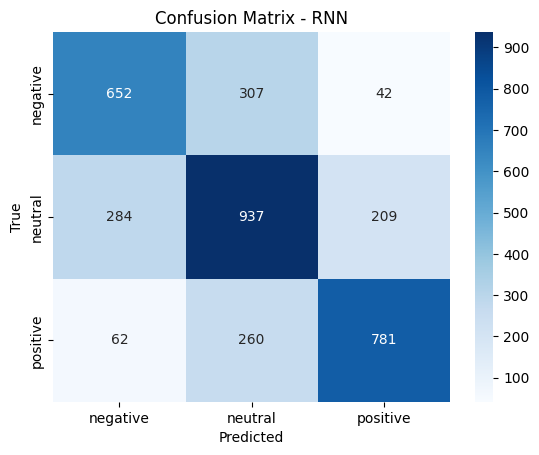


Training LSTM model...
Epoch 1/3


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/embedding.py:90: UserWarning:

Argument `input_length` is deprecated. Just remove it.



430/430 - 15s - 36ms/step - accuracy: 0.6187 - loss: 0.8284 - val_accuracy: 0.5846 - val_loss: 0.8892
Epoch 2/3
430/430 - 5s - 11ms/step - accuracy: 0.7713 - loss: 0.5645 - val_accuracy: 0.7080 - val_loss: 0.7081
Epoch 3/3
430/430 - 5s - 11ms/step - accuracy: 0.8528 - loss: 0.3865 - val_accuracy: 0.7035 - val_loss: 0.7409
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step

Classification Report:
              precision    recall  f1-score   support

    negative       0.69      0.66      0.68      1001
     neutral       0.65      0.72      0.68      1430
    positive       0.80      0.72      0.76      1103

    accuracy                           0.70      3534
   macro avg       0.71      0.70      0.71      3534
weighted avg       0.71      0.70      0.70      3534

Confusion Matrix:


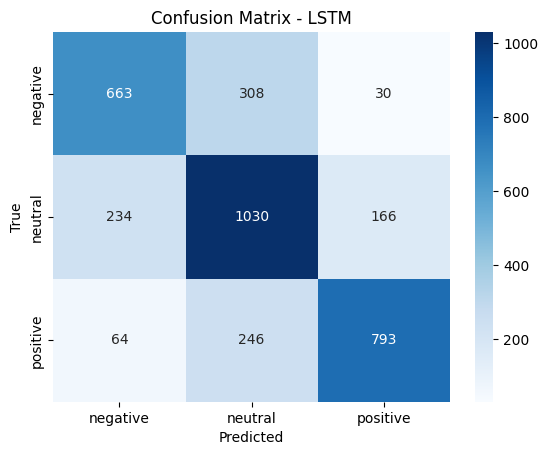


Training BiLSTM model...
Epoch 1/3


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/embedding.py:90: UserWarning:

Argument `input_length` is deprecated. Just remove it.



430/430 - 13s - 30ms/step - accuracy: 0.6314 - loss: 0.8081 - val_accuracy: 0.6395 - val_loss: 0.7986
Epoch 2/3
430/430 - 7s - 16ms/step - accuracy: 0.8035 - loss: 0.4869 - val_accuracy: 0.6678 - val_loss: 0.7535
Epoch 3/3
430/430 - 10s - 24ms/step - accuracy: 0.8980 - loss: 0.2751 - val_accuracy: 0.6811 - val_loss: 0.8410
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step

Classification Report:
              precision    recall  f1-score   support

    negative       0.65      0.71      0.68      1001
     neutral       0.66      0.61      0.63      1430
    positive       0.73      0.76      0.74      1103

    accuracy                           0.68      3534
   macro avg       0.68      0.69      0.68      3534
weighted avg       0.68      0.68      0.68      3534

Confusion Matrix:


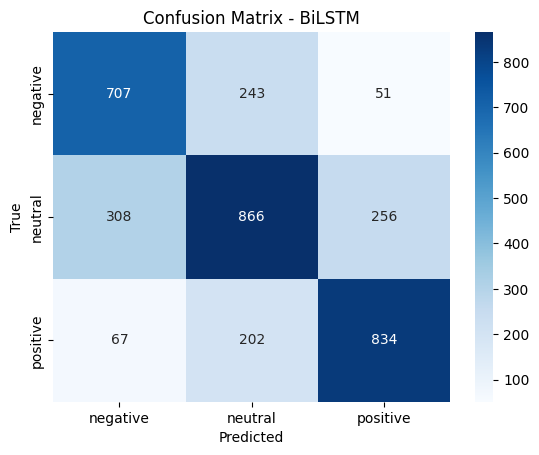


Training GRU model...
Epoch 1/3


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/embedding.py:90: UserWarning:

Argument `input_length` is deprecated. Just remove it.



430/430 - 10s - 23ms/step - accuracy: 0.5631 - loss: 0.9005 - val_accuracy: 0.3664 - val_loss: 1.0146
Epoch 2/3
430/430 - 10s - 23ms/step - accuracy: 0.7662 - loss: 0.5692 - val_accuracy: 0.3373 - val_loss: 1.8330
Epoch 3/3
430/430 - 4s - 10ms/step - accuracy: 0.8689 - loss: 0.3485 - val_accuracy: 0.6604 - val_loss: 0.8657
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step

Classification Report:
              precision    recall  f1-score   support

    negative       0.84      0.43      0.57      1001
     neutral       0.55      0.91      0.69      1430
    positive       0.91      0.55      0.68      1103

    accuracy                           0.66      3534
   macro avg       0.77      0.63      0.65      3534
weighted avg       0.74      0.66      0.65      3534

Confusion Matrix:


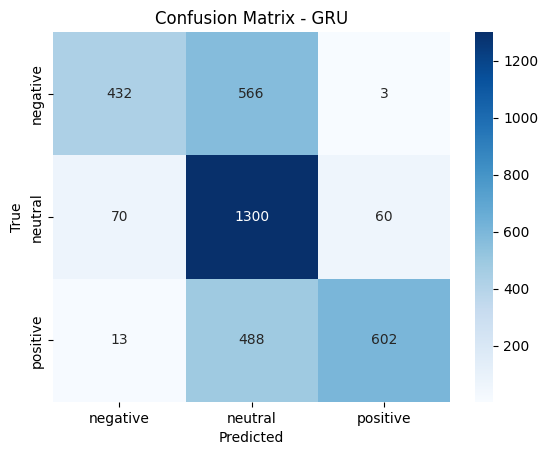


Training BiGRU model...
Epoch 1/3


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/embedding.py:90: UserWarning:

Argument `input_length` is deprecated. Just remove it.



430/430 - 14s - 33ms/step - accuracy: 0.6351 - loss: 0.8031 - val_accuracy: 0.5158 - val_loss: 1.0192
Epoch 2/3
430/430 - 9s - 21ms/step - accuracy: 0.8218 - loss: 0.4552 - val_accuracy: 0.6302 - val_loss: 0.8915
Epoch 3/3
430/430 - 7s - 17ms/step - accuracy: 0.9110 - loss: 0.2460 - val_accuracy: 0.6406 - val_loss: 1.2239
111/111 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step

Classification Report:
              precision    recall  f1-score   support

    negative       0.52      0.87      0.65      1001
     neutral       0.68      0.46      0.55      1430
    positive       0.81      0.67      0.74      1103

    accuracy                           0.64      3534
   macro avg       0.67      0.67      0.65      3534
weighted avg       0.68      0.64      0.64      3534

Confusion Matrix:


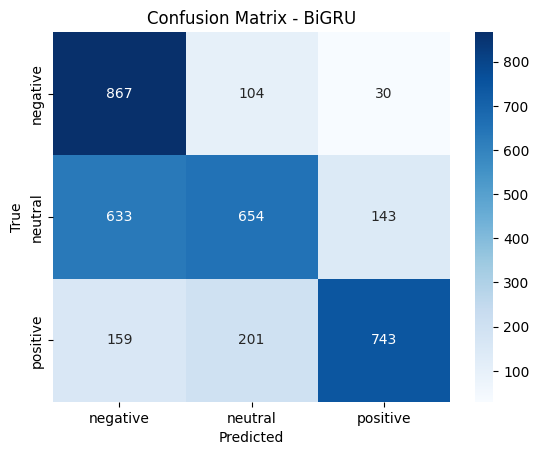

In [83]:
model_types = ['RNN', 'LSTM', 'BiLSTM', 'GRU', 'BiGRU']
vocab_size = len(tokenizer.word_index) + 1
embedding_dim = 128
input_length = max_length

for model_type in model_types:
    print(f"\n{'='*40}\nTraining {model_type} model...\n{'='*40}")
    model = create_model(model_type, vocab_size, embedding_dim, input_length)
    model.fit(X_train, y_train, epochs=3, batch_size=64, validation_data=(X_test, y_test), verbose=2)

    # Evaluate
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = np.argmax(y_test, axis=1)

    print("\nClassification Report:")
    print(classification_report(y_true, y_pred_classes, target_names=label_encoder.classes_))

    print("Confusion Matrix:")
    cm = confusion_matrix(y_true, y_pred_classes)
    df_cm = pd.DataFrame(cm, index=label_encoder.classes_, columns=label_encoder.classes_)
    sns.heatmap(df_cm, annot=True, fmt='d', cmap='Blues')
    plt.title(f'Confusion Matrix - {model_type}')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()